In [1]:
# Parametersh5_name = '{PATH_1}'protosp_path = '{PATH_2}'library = "CRISPR-DMSO2"tsv_path = '{PATH_3}'

In [2]:
library(Seurat)
library(SeuratDisk)
library(dplyr)
library(ggplot2)
library(patchwork)
library(stringr)
library(crayon)

The legacy packages maptools, rgdal, and rgeos, underpinning the sp package,
which was just loaded, will retire in October 2023.
Please refer to R-spatial evolution reports for details, especially
https://r-spatial.org/r/2023/05/15/evolution4.html.
It may be desirable to make the sf package available;
package maintainers should consider adding sf to Suggests:.
The sp package is now running under evolution status 2
     (status 2 uses the sf package in place of rgdal)



Attaching SeuratObject



Registered S3 method overwritten by 'SeuratDisk':
  method            from  
  as.sparse.H5Group Seurat




Attaching package: ‘dplyr’




The following objects are masked from ‘package:stats’:

    filter, lag




The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union





Attaching package: ‘crayon’




The following object is masked from ‘package:ggplot2’:

    %+%




In [3]:
#setwd("~/prj/catatac/scripts")

# Load guide-capture data

Define paths etc

In [4]:
# Pass these as parameters# h5_name = '{PATH_4}'# protosp_path = '{PATH_5}'# library = "CRISPR8"# tsv_path = '{PATH_6}'

In [5]:
h5_w_gcap_name <- sub(".h5seurat", "_w_GUIDE_CAP.h5seurat", h5_name)barcode2guide_tsv_path <- paste0(tsv_path, '{PATH_7}')tsv_name <- paste0(tsv_path, '{PATH_8}')

### Load protospacer file

In [6]:
df_protosp = read.table(protosp_path, header=TRUE, comment.char="")

In [7]:
tfs_w_ntctl    = unique(df_protosp$X.TargetGene)
unselect_ntctl = (tfs_w_ntctl != "NTCTL") & (tfs_w_ntctl != "NTCTRL")
tfs_to_plot    = tfs_w_ntctl[unselect_ntctl]

guides_to_plot  = df_protosp$GuideName
tfs_to_plot
guides_to_plot

[1] "CHD2"   "HIC2"   "MNT"    "NTC28"  "NTC36"  "NTC74"  "NTC82"  "PIAS1" 
[9] "YEATS4"

[1] "CHD2_1"   "CHD2_2"   "HIC2_1"   "HIC2_2"   "MNT_1"    "MNT_2"   
 [7] "NTC28_1"  "NTC28_2"  "NTC36_1"  "NTC74_2"  "NTC82_1"  "PIAS1_1" 
[13] "PIAS1_2"  "YEATS4_1" "YEATS4_2"

In [8]:
df_protosp

X.TargetGene,GuideName,value
<chr>,<chr>,<chr>
CHD2,CHD2_1,GCAGAGCGCGCTCTCTCTA
CHD2,CHD2_2,ACGACCTGGGCTCTCAGTA
HIC2,HIC2_1,TCGGCCCGCGACTCCTGTT
HIC2,HIC2_2,CGGCTGTGAGCGGCGCTCG
MNT,MNT_1,GCGGGGGCGTACTACACCG
MNT,MNT_2,GAGTCCCGCCGACAAGAAA
NTC28,NTC28_1,GGTGGCCTTTGCAATTGGCG
NTC28,NTC28_2,GCGCTAGGAAACCAACAAGG
NTC36,NTC36_1,GCAGCGAGCAGCTTTTACGA


In [9]:
#c("OTP", "MYF6", "MEIS1", "FLI1", "HHEX", "HOXA6", "ELF5", "GBX1", "DPRX", "NTCTL")
##!! tf_list   <- tfs_w_ntctl 

df_guide <- read.table(tsv_name, header = TRUE, sep = "\t", quote = "")
tf_list  <- intersect(guides_to_plot, colnames(df_guide))

guide_counts  <- t(data.matrix(df_guide[,tf_list]))
colnames(guide_counts) <- df_guide$barcode_dash
guide_counts

,AAACAGCCAAACTGCC-1,AAACAGCCAAACTGTT-1,AAACAGCCAAATATCC-1,AAACAGCCAACACCTA-1,AAACAGCCAACATAAG-1,AAACAGCCAACCCTAA-1,AAACAGCCAACCCTCC-1,AAACAGCCAACCTGGT-1,AAACAGCCAACTAACT-1,AAACAGCCAACTAGGG-1,⋯,TTTGTTGGTTGTCCAT-1,TTTGTTGGTTGTTGCT-1,TTTGTTGGTTTAAAGC-1,TTTGTTGGTTTAGCGA-1,TTTGTTGGTTTAGTCC-1,TTTGTTGGTTTGACCT-1,TTTGTTGGTTTGCGCC-1,TTTGTTGGTTTGGCGG-1,TTTGTTGGTTTGGGCG-1,TTTGTTGGTTTGTTGC-1
CHD2_1,0,0,0,0,0,0,0,163,0,30,⋯,0,0,0,0,0,0,0,0,1,0
CHD2_2,78,0,0,0,0,0,0,54,0,0,⋯,0,0,0,0,0,0,0,0,0,0
HIC2_1,0,0,0,0,0,1,0,0,0,0,⋯,0,0,0,1,1,0,0,0,1,1
HIC2_2,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
MNT_1,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,1,1,0
MNT_2,0,0,0,0,0,0,0,0,0,0,⋯,0,0,29,0,0,0,0,0,0,0
NTC28_1,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
NTC28_2,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
NTC36_1,0,0,0,0,0,0,0,0,0,0,⋯,1,0,55,1,0,0,0,0,0,0
NTC74_2,0,0,0,0,1,0,0,840,74,93,⋯,0,0,91,0,0,0,0,0,0,0


Get overlapping cells

In [10]:
N_MIN_GUIDES <- 10
select_overlapping   <-
    df_guide$in_multiome & (df_guide$n_guides >= N_MIN_GUIDES)

overlapping_barcodes <- df_guide[select_overlapping, ]$barcode_dash
overlapping_barcodes <- as.vector(overlapping_barcodes)

overlapping_guide_counts <- guide_counts[, overlapping_barcodes]

n_all_overlapping <- nrow(df_guide[df_guide$in_multiome, ])
paste("Overlapping barcodes w/ min guides =", N_MIN_GUIDES,": ", length(overlapping_barcodes))
paste("Overlapping barcodes w/ min guides =", 1,": ", n_all_overlapping)


[1] "Overlapping barcodes w/ min guides = 10 :  8024"

[1] "Overlapping barcodes w/ min guides = 1 :  8028"

In [11]:
head(overlapping_guide_counts)

,AAACAGCCAACCCTCC-1,AAACAGCCAGCATGGA-1,AAACAGCCAGGCATCT-1,AAACAGCCATTAGCCA-1,AAACATGCAAAGCTCC-1,AAACATGCAATAGCCC-1,AAACATGCACAGGGAC-1,AAACATGCACCAACCG-1,AAACATGCAGGACACA-1,AAACATGCATCATGGC-1,⋯,TTTGTGAAGGCGCTAC-1,TTTGTGAAGTAACAGG-1,TTTGTGAAGTAAGGGC-1,TTTGTGAAGTAGCTTA-1,TTTGTGGCACCAGCAT-1,TTTGTGGCACGAATCC-1,TTTGTGTTCATGCCTC-1,TTTGTGTTCTATTGTC-1,TTTGTGTTCTCACTCA-1,TTTGTTGGTTGGTTGA-1
CHD2_1,0,0,0,153,144,0,68,29,205,0,⋯,0,72,0,0,0,0,0,0,0,0
CHD2_2,0,0,0,0,240,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0
HIC2_1,0,1000,0,0,1,0,0,0,0,0,⋯,66,95,0,97,0,0,0,0,31,0
HIC2_2,0,152,0,0,0,0,0,0,27,102,⋯,0,0,0,0,0,0,0,0,0,0
MNT_1,0,191,0,0,906,0,349,70,0,0,⋯,0,152,0,56,0,51,0,0,37,317
MNT_2,0,0,0,0,1385,145,183,0,0,0,⋯,0,0,0,82,34,0,454,0,0,0


In [12]:
head(overlapping_barcodes)

[1] "AAACAGCCAACCCTCC-1" "AAACAGCCAGCATGGA-1" "AAACAGCCAGGCATCT-1"
[4] "AAACAGCCATTAGCCA-1" "AAACATGCAAAGCTCC-1" "AAACATGCAATAGCCC-1"

## Plot stats

Mean #guides per cell 1144.124

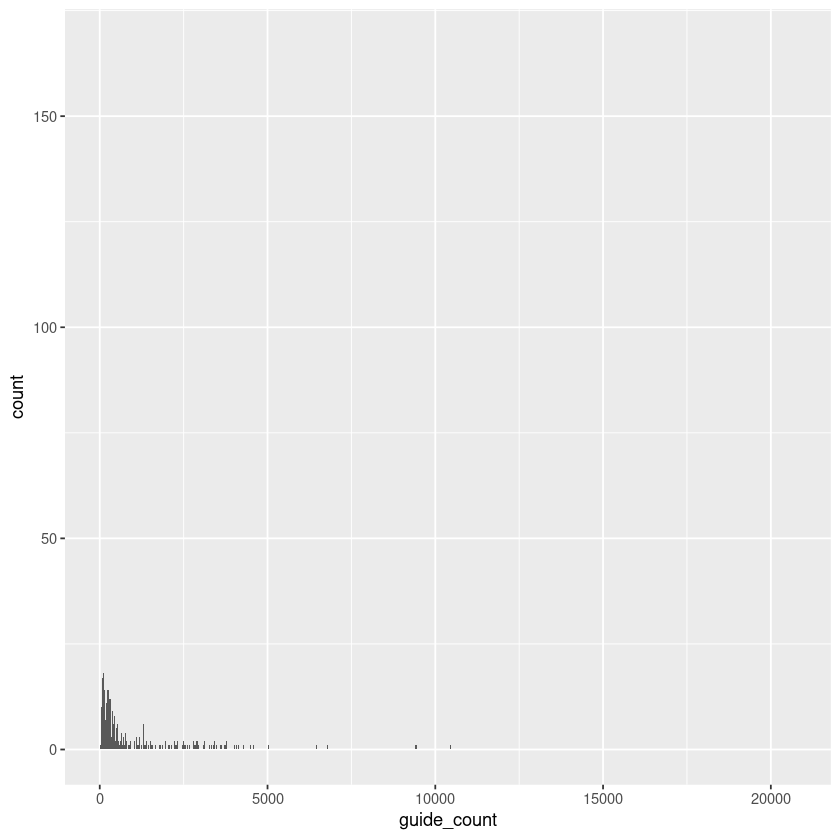

In [13]:
df_guide_counts_per_cell <- data.frame(guide_count=colSums(overlapping_guide_counts))
mean_guides_per_cell = mean(df_guide_counts_per_cell$guide_count)
cat(blue("Mean #guides per cell"), mean_guides_per_cell)

ggplot(df_guide_counts_per_cell, aes(x=guide_count)) +
    geom_histogram(binwidth=1)

No id variables; using all as measure variables



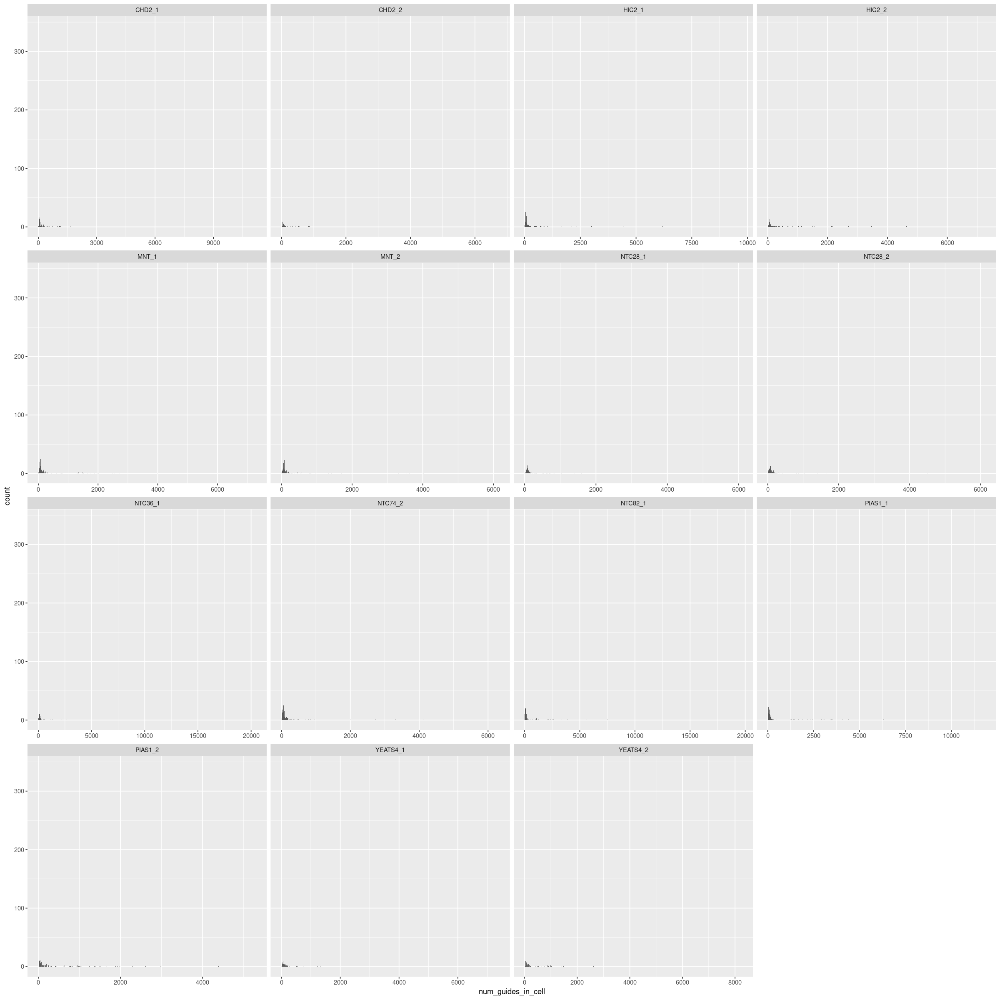

In [14]:
library(reshape2)
df_guide_counts_by_cell <- as.data.frame(t(overlapping_guide_counts))

d <- melt(df_guide_counts_by_cell)
d <- d[d$value > 0,]
colnames(d) = c("guide_name", "num_guides_in_cell")

options(repr.plot.width = 20, repr.plot.height = 20)
ggplot(d, aes(x = num_guides_in_cell)) + 
    facet_wrap(~guide_name, scales = "free_x") + 
    geom_histogram(binwidth=1) +
    labs(y_label="count") 

No id variables; using all as measure variables



Warning message in geom_histogram(bin_breaks = bin_breaks):
“Ignoring unknown parameters: `bin_breaks`”


`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


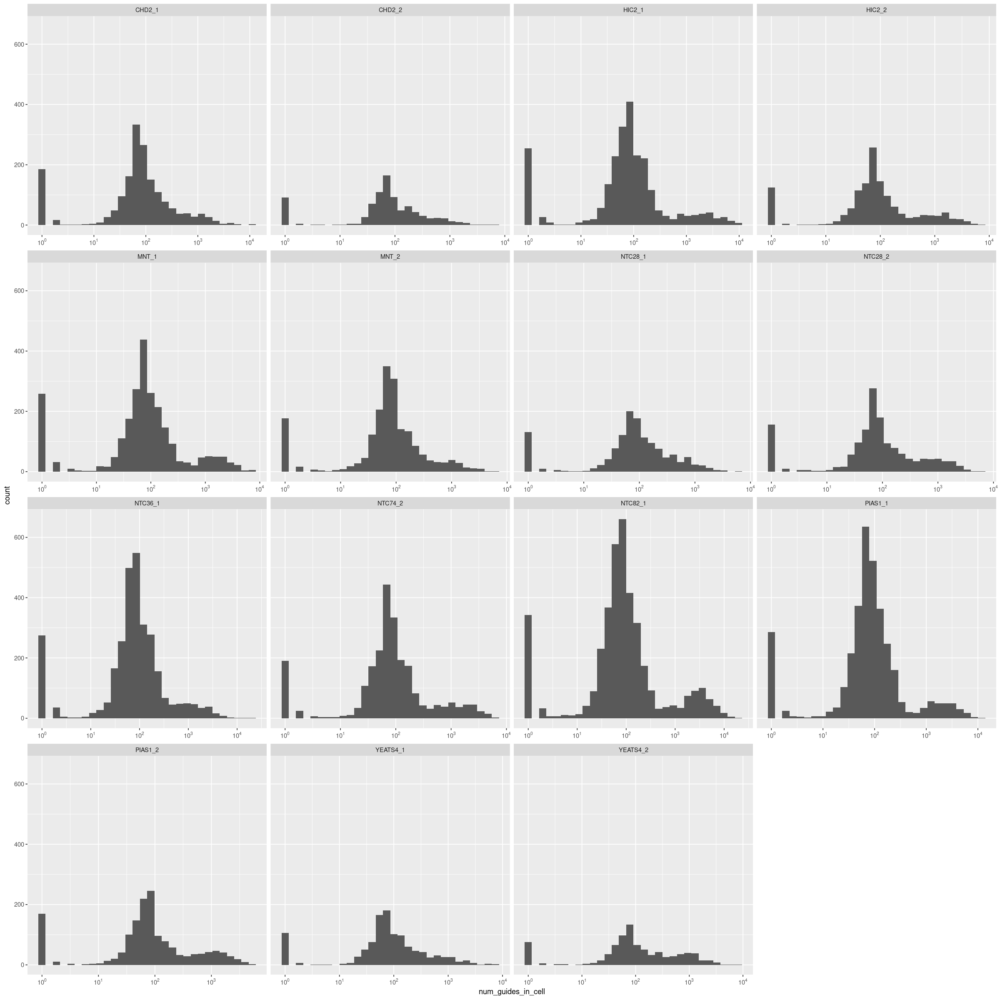

In [15]:
### Using log scales
library(reshape2)
library(scales)
df_guide_counts_by_cell <- as.data.frame(t(overlapping_guide_counts))

d <- melt(df_guide_counts_by_cell)
d <- d[d$value > 0,]
colnames(d) = c("guide_name", "num_guides_in_cell")

bin_breaks <- c(1,2,2*2^(1:16))

options(repr.plot.width = 20, repr.plot.height = 20)
ggplot(d, aes(x = num_guides_in_cell)) + 
    facet_wrap(~guide_name, scales = "free_x") + 
    geom_histogram(bin_breaks=bin_breaks) +
    scale_x_log10(labels=trans_format('log10',math_format(10^.x)), breaks=c(1,10,100,1000,10000,100000)) +
    labs(y_label="count") 

# Demux

Load multiome seurat object

In [16]:
if (!exists("seurat_all")) {
    seurat_all <- LoadH5Seurat(h5_name, verbose=FALSE)
}

Validating h5Seurat file



Loading required package: Signac



rgeos version: 0.6-3, (SVN revision 696)
 GEOS runtime version: 3.8.0-CAPI-1.13.1 
 Please note that rgeos will be retired during October 2023,
plan transition to sf or terra functions using GEOS at your earliest convenience.
See https://r-spatial.org/r/2023/05/15/evolution4.html for details.
 Linking to sp version: 2.0-0 
 Polygon checking: TRUE 




In [17]:
# Select cells found in guide capture
seurat     <- subset(seurat_all, cells = overlapping_barcodes)
n_multiome <- length(Cells(seurat_all))

In [18]:
# Add guide data as a new assay independent from RNA & ATAC
seurat[["guidecapture"]] <- CreateAssayObject(counts = overlapping_guide_counts)

Warning message:
“Feature names cannot have underscores ('_'), replacing with dashes ('-')”


In [19]:
# x <- GetAssayData(seurat, "counts")
# cells <- colnames(x[ , colSums(x) != 0])
# feats <- names((rowSums(x) != 0) == TRUE)
# seurat <- seurat[feats, cells] 

In [20]:
# Normalize guide data, here we use centered log-ratio (CLR) transformation
seurat <- NormalizeData(seurat, assay = "guidecapture", normalization.method = "CLR")

Normalizing across features



In [21]:
seurat <- HTODemux(seurat, assay = "guidecapture", positive.quantile = 0.99, seed = 85253310)

Cutoff for CHD2-1 : 281 reads



Cutoff for CHD2-2 : 109 reads



Cutoff for HIC2-1 : 4 reads



Cutoff for HIC2-2 : 160 reads



Cutoff for MNT-1 : 4 reads



Cutoff for MNT-2 : 141 reads



Cutoff for NTC28-1 : 94 reads



Cutoff for NTC28-2 : 124 reads



Cutoff for NTC36-1 : 6 reads



Cutoff for NTC74-2 : 6 reads



Cutoff for NTC82-1 : 434 reads



Cutoff for PIAS1-1 : 65 reads



Cutoff for PIAS1-2 : 70 reads



Cutoff for YEATS4-1 : 1 reads



Cutoff for YEATS4-2 : 79 reads



In [22]:
unique(seurat$guidecapture_secondID)

[1] "CHD2-1"   "HIC2-2"   "PIAS1-1"  "NTC36-1"  "MNT-1"    "NTC82-1" 
 [7] "MNT-2"    "YEATS4-1" "PIAS1-2"  "CHD2-2"   "NTC28-2"  "YEATS4-2"
[13] "NTC28-1"  "NTC74-2"  "HIC2-1"

# Visualize

In [23]:
if (!exists("seurat")) {
    seurat <- LoadH5Seurat(h5_w_gcap_name)
}

In [24]:
# Global classification results
n_cells <- length(seurat$guidecapture_classification.global)
demux_counts      <- table(seurat$guidecapture_classification.global)
demux_percentages <- round(demux_counts/n_cells, 2)

demux_counts
demux_percentages

n_doublets <- demux_counts[["Doublet"]]
n_singlets <- demux_counts[["Singlet"]]

capture_efficiency_1 <- 100*(n_doublets + n_singlets) / n_multiome
paste("Capture efficiency% = ", round(capture_efficiency_1), "( norm by", n_multiome, ")")

#capture_efficiency_2 <- 100 * (n_doublets + n_singlets) / n_all_overlapping
#paste("Capture efficiency%", round(capture_efficiency_2), "( norm by", n_all_overlapping, ")")


 Doublet Negative  Singlet 
    4980      963     2081 


 Doublet Negative  Singlet 
    0.62     0.12     0.26 

[1] "Capture efficiency% =  88 ( norm by 8042 )"

In [25]:
length(Cells(seurat))

[1] 8024

In [26]:
# Group cells based on the max HTO signal
guide_names <- rownames(seurat[["guidecapture"]])
num_pcs     <- length(guide_names)

Picking joint bandwidth of 9.81



Picking joint bandwidth of 7.05



Picking joint bandwidth of 16.1



Picking joint bandwidth of 14.2



Picking joint bandwidth of 12.8



Picking joint bandwidth of 6.57



Picking joint bandwidth of 7.37



Picking joint bandwidth of 8.75



Picking joint bandwidth of 24.9



Picking joint bandwidth of 23.1



Picking joint bandwidth of 137



Picking joint bandwidth of 24.4



Picking joint bandwidth of 6.39



Picking joint bandwidth of 6.68



Picking joint bandwidth of 15.2



Picking joint bandwidth of 0.0765



Picking joint bandwidth of 0.0432



Picking joint bandwidth of 0.273



Picking joint bandwidth of 0.0682



Picking joint bandwidth of 0.235



Picking joint bandwidth of 0.073



Picking joint bandwidth of 0.0477



Picking joint bandwidth of 0.0468



Picking joint bandwidth of 0.437



Picking joint bandwidth of 0.316



Picking joint bandwidth of 0.479



Picking joint bandwidth of 0.452



Picking joint bandwidth of 0.0509



Picking joint bandwidth of 0.0603



Picking joint bandwidth of 0.0539



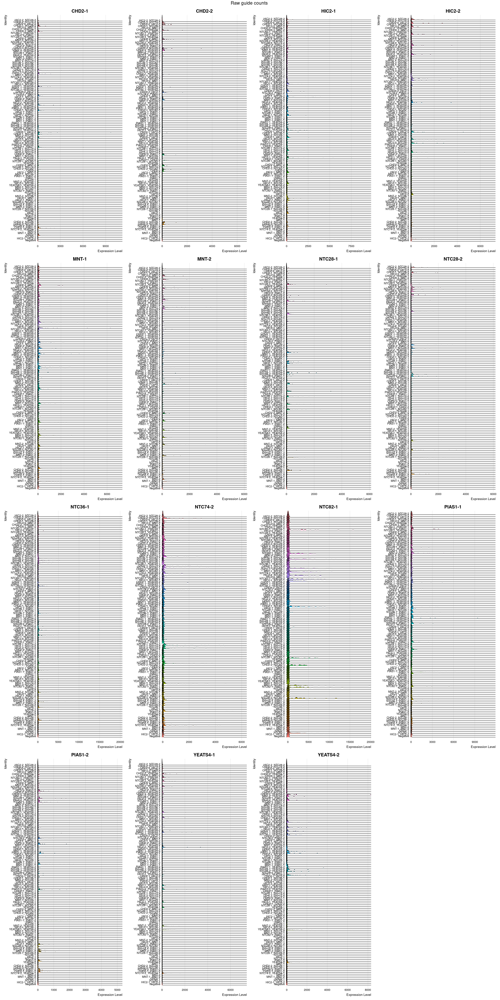

Warning message in FetchData.Seurat(object = object, vars = features, slot = slot):
“The following requested variables were not found: NTC28, NTC36, NTC74, NTC82”


Picking joint bandwidth of 0.236



Picking joint bandwidth of 0.201



Picking joint bandwidth of 4.38e-06



Picking joint bandwidth of 0.22



Picking joint bandwidth of 0.162



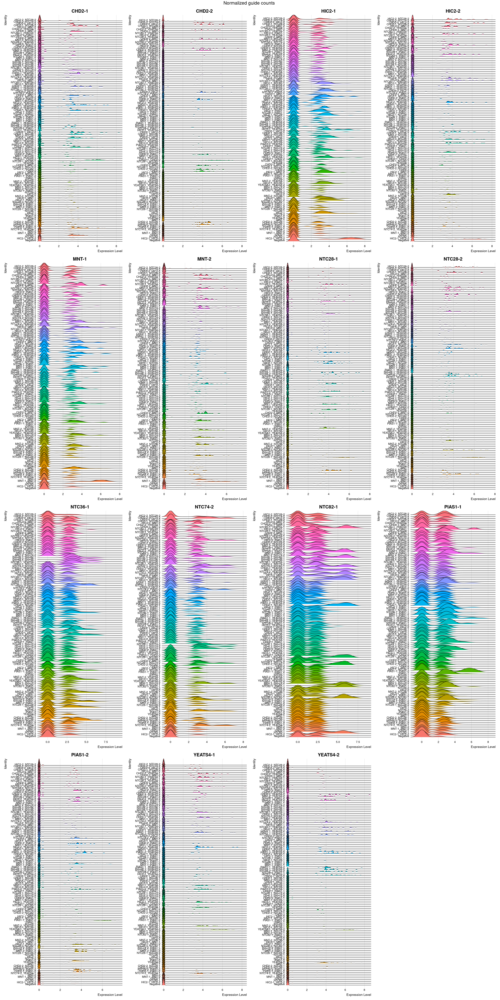

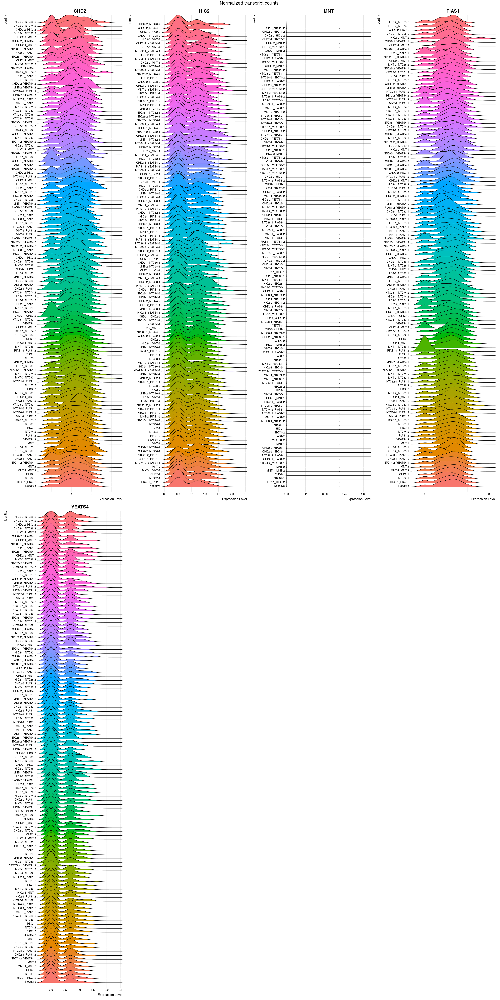

In [27]:
options(repr.plot.width = 30, repr.plot.height = 60)
tf_list <- tfs_to_plot

Idents(seurat) <- "guidecapture_classification"

RidgePlot(
    seurat,
    assay = "guidecapture",
    features = guide_names,
    slot="counts",
    ncol = 4
) + plot_annotation(title = "Raw guide counts") & theme(plot.title = element_text(hjust = 0.5, size = 20))

RidgePlot(
    seurat,
    assay = "guidecapture",
    features = guide_names,
    ncol = 4
) + plot_annotation(title = "Normalized guide counts") & theme(plot.title = element_text(hjust = 0.5, size = 20))

RidgePlot(
    seurat,
    assay = "SCT",
    features = tf_list,
    ncol = 4,
    y.max = .5
)+ plot_annotation(title = "Normalized transcript counts") & theme(plot.title = element_text(hjust = 0.5, size = 20))

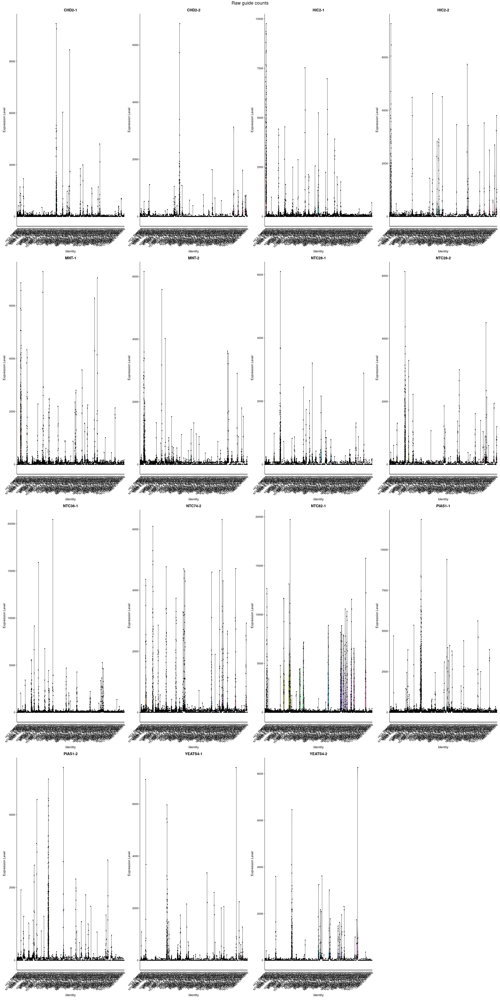

In [28]:
VlnPlot(
    seurat,
    assay = "guidecapture",
    features = guide_names,
    slot="counts",
    ncol = 4
) + plot_annotation(title = "Raw guide counts", 
                    theme = theme(plot.title = element_text(hjust = 0.5, size = 20)))


In [29]:
# FeatureScatter(seurat, feature1 = "GATA5", feature2 = "MEOX1")
# FeatureScatter(seurat, feature1 = "GATA5", feature2 = "NEUROG2")
# FeatureScatter(seurat, feature1 = "MEOX1", feature2 = "NEUROG2")

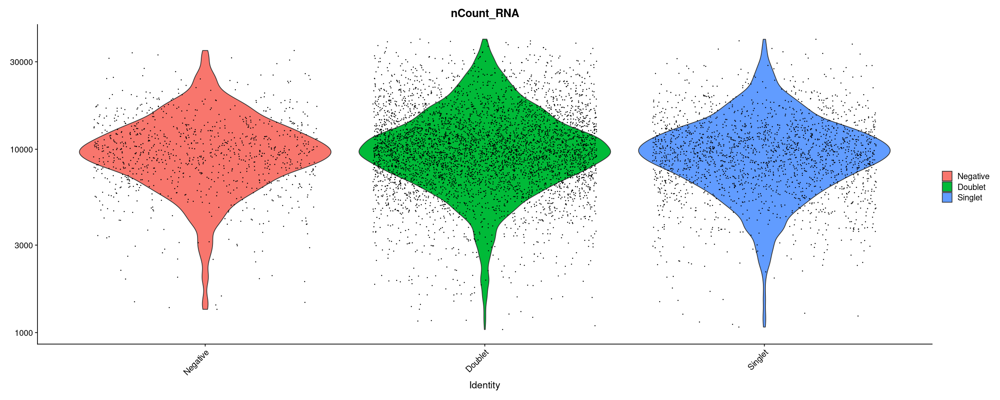

In [30]:
options(repr.plot.width = 20, repr.plot.height = 8)
Idents(seurat) <- "guidecapture_classification.global"
VlnPlot(seurat, features = "nCount_RNA", pt.size = 0.1, log = TRUE)

In [31]:
# First, we will remove negative cells from the object
seurat_subset <- subset(seurat, idents = "Negative", invert = TRUE)

# Calculate a tSNE embedding of the HTO data
DefaultAssay(seurat_subset) <- "guidecapture"

In [32]:

seurat_subset <-
    ScaleData(seurat_subset, features = guide_names, verbose = FALSE)

# seurat_subset <- RunPCA(
#     seurat_subset,
#     npcs = num_pcs,
#     ndims.print = 1:num_pcs,
#     features = guide_names,
#     approx = FALSE
# )

# seurat_subset <-
#     RunTSNE(
#         seurat_subset,
#         dims = 1:num_pcs,
#         perplexity = 100,
#         check_duplicates = FALSE
#     )

# seurat_subset <-
#     RunUMAP(seurat_subset, dims = 1:num_pcs)

#DimPlot(seurat_subset, reduction = "tsne")

Warning message:
“The `<scale>` argument of `guides()` cannot be `FALSE`. Use "none" instead as of ggplot2 3.3.4.
ℹ The deprecated feature was likely used in the Seurat package.
  Please report the issue at <https://github.com/satijalab/seurat/issues>.”


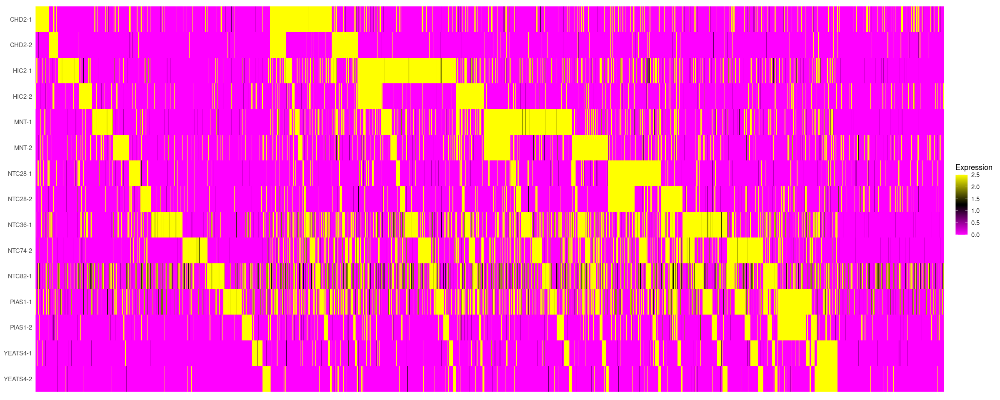

In [33]:
HTOHeatmap(seurat, assay = "guidecapture")

In [34]:
SaveH5Seurat(seurat, h5_w_gcap_name, overwrite = TRUE, verbose = FALSE)

Warning message:
“Overwriting previous file /data2/kfeng/deeper_guides_dasatinib/secondary/DMSO2/seurat/CATATAC_CRISPR-DMSO2_ONLY_SINGLETS_w_GUIDE_CAP.h5seurat”


Creating h5Seurat file for version 3.1.5.9900



# Inspect results

In [35]:
# Label each cell with the number of guides detected in it by HTOdemux
seurat$perturb_targets_detected_in_cell <- colSums(sapply(seurat$guidecapture_classification, str_detect, tfs_w_ntctl))

In [36]:
# Split the surat obj into singlets, doublets, negatives
# Singlets have only one target gene detected, but can have both guides targeting it.
seurat_negatives <- subset(seurat, idents = "Negative")
seurat_singlets  <- subset(seurat, perturb_targets_detected_in_cell == 1)
seurat_doublets  <- subset(seurat, perturb_targets_detected_in_cell > 1)

In [37]:
# Assign the target gene name to singlets
x <- seurat_singlets$guidecapture_classification
target_assignments = sapply(tfs_w_ntctl, function(y) grep(y,x))

empty_vec = vector("character", length(x))
for(tf in names(target_assignments)) {
    indexes = target_assignments[[tf]]
    empty_vec[indexes] = tf
}

In [38]:
Idents(seurat_singlets) <- empty_vec
Idents(seurat_doublets) <- seurat_doublets@meta.data$guidecapture_classification

### Singlets

In [39]:
singlet_barcodes <- Cells(seurat_singlets)
select_singlets  <- df_guide$barcode_dash %in% singlet_barcodes
df_singlets      <- df_guide[select_singlets, ]

In [40]:
options(repr.plot.width = 16, repr.plot.height = 6)

plot_n_guides <- ggplot(df_singlets, aes(x = n_guides)) +
    geom_histogram(binwidth = 1) +
    labs(title = "Singlets, guide counts", x = "#guides captured") +
    labs(y = "#cells")

plot_dominant <- ggplot(df_singlets, aes(x = percent_dominant_gene)) +
    geom_histogram(binwidth = 1) +
    labs(title = "Singlets, %dominant gene", x = "%dominant gene") +
    labs(y = "#cells")

plot_n_guides | plot_dominant

ERROR while rich displaying an object: Error in `geom_histogram()`:
! Problem while computing aesthetics.
ℹ Error occurred in the 1st layer.
Caused by error:
! object 'percent_dominant_gene' not found

Traceback:
1. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
2. tryCatchList(expr, classes, parentenv, handlers)
3. tryCatchOne(expr, names, parentenv, handlers[[1L]])
4. doTryCatch(return(expr), name, parentenv, handler)
5. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, er

### Negatives

In [41]:
negative_barcodes <- Cells(seurat_negatives)
select_negatives  <- df_guide$barcode_dash %in% negative_barcodes
df_negatives      <- df_guide[select_negatives, ]

In [42]:
options(repr.plot.width = 16, repr.plot.height = 6)

plot_n_guides <- ggplot(df_negatives, aes(x = n_guides)) +
    geom_histogram(binwidth = 1) +
    labs(title = "Negatives, guide counts", x = "#guides captured") +
    labs(y = "#cells")

plot_dominant <- ggplot(df_negatives, aes(x = percent_dominant_gene)) +
    geom_histogram(binwidth = 1) +
    labs(title = "Negatives, %dominant gene", x = "%dominant gene") +
    labs(y = "#cells")

plot_n_guides | plot_dominant

ERROR while rich displaying an object: Error in `geom_histogram()`:
! Problem while computing aesthetics.
ℹ Error occurred in the 1st layer.
Caused by error:
! object 'percent_dominant_gene' not found

Traceback:
1. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
2. tryCatchList(expr, classes, parentenv, handlers)
3. tryCatchOne(expr, names, parentenv, handlers[[1L]])
4. doTryCatch(return(expr), name, parentenv, handler)
5. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, er

In [43]:
sample_n(df_negatives, 10)

barcode,n_guides,ADNP_1,ADNP_2,BRD2_1,BRD2_2,CHD2_1,CHD2_2,CNOT2_1,CNOT2_2,⋯,YEATS4_1,YEATS4_2,ZBED6_1,ZBED6_2,ZNF330_1,ZNF330_2,ZNF669_1,ZNF669_2,barcode_dash,in_multiome
<chr>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<chr>,<lgl>
TCGGTAAGTGGATTCA,45,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,TCGGTAAGTGGATTCA-1,TRUE
GGTGCTGGTCCTCCAA,145,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,GGTGCTGGTCCTCCAA-1,TRUE
ACTTGTCGTCACTCGC,680,0,0,0,0,0,0,0,0,⋯,0,45,0,0,0,0,0,0,ACTTGTCGTCACTCGC-1,TRUE
TTGCAGCCAGCACCAT,890,0,0,0,0,0,0,0,0,⋯,0,0,81,0,0,0,0,50,TTGCAGCCAGCACCAT-1,TRUE
GAGCGGTCAGGGAGGA,824,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,109,GAGCGGTCAGGGAGGA-1,TRUE
CTTGCATGTAAGCTTG,1619,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,1,CTTGCATGTAAGCTTG-1,TRUE
CCACAATAGCAATAGG,3677,1,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,1,CCACAATAGCAATAGG-1,TRUE
CAGGCTGGTTGACTTC,192,0,88,0,0,0,0,0,24,⋯,0,0,0,0,0,0,0,0,CAGGCTGGTTGACTTC-1,TRUE
ATCACTAAGTCAGTAC,521,0,0,58,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,ATCACTAAGTCAGTAC-1,TRUE


In [44]:
#hist(df_singlets$GATA5)

In [45]:
library(cluster)
library(fitdistrplus)

MaxN <- function(x, N = 2){
  len <- length(x)
  if (N > len) {
    warning('N greater than length(x).  Setting N=length(x)')
    N <- length(x)
  }
  sort(x, partial = len - N + 1)[len - N + 1]
}

myHTODemux <- function(
  object,
  assay = "HTO",
  positive.quantile = 0.99,
  init = NULL,
  nstarts = 100,
  kfunc = "clara",
  nsamples = 100,
  seed = 42,
  verbose = TRUE
) {
  if (!is.null(x = seed)) {
    set.seed(seed = seed)
  }
  #initial clustering
  assay <- assay %||% DefaultAssay(object = object)
  data <- GetAssayData(object = object, assay = assay)
  counts <- GetAssayData(
    object = object,
    assay = assay,
    slot = 'counts'
  )[, colnames(x = object)]
  counts <- as.matrix(x = counts)
  ncenters <- init %||% (nrow(x = data) + 1)
  switch(
    EXPR = kfunc,
    'kmeans' = {
      init.clusters <- kmeans(
        x = t(x = GetAssayData(object = object, assay = assay)),
        centers = ncenters,
        nstart = nstarts
      )
      #identify positive and negative signals for all HTO
      Idents(object = object, cells = names(x = init.clusters$cluster)) <- init.clusters$cluster
    },
    'clara' = {
      #use fast k-medoid clustering
      init.clusters <- clara(
        x = t(x = GetAssayData(object = object, assay = assay)),
        k = ncenters,
        samples = nsamples
      )
      #identify positive and negative signals for all HTO
      Idents(object = object, cells = names(x = init.clusters$clustering), drop = TRUE) <- init.clusters$clustering
    },
    stop("Unknown k-means function ", kfunc, ", please choose from 'kmeans' or 'clara'")
  )
  #average hto signals per cluster
  #work around so we don't average all the RNA levels which takes time
  average.expression <- AverageExpression(
    object = object,
    assays = assay,
    verbose = FALSE
  )[[assay]]
  #checking for any cluster with all zero counts for any barcode
  if (sum(average.expression == 0) > 0) {
    stop("Cells with zero counts exist as a cluster.")
  }
  #create a matrix to store classification result
  discrete <- GetAssayData(object = object, assay = assay)
  discrete[discrete > 0] <- 0
  # for each HTO, we will use the minimum cluster for fitting
  for (iter in rownames(x = data)) {
    values <- counts[iter, colnames(object)]
    #commented out if we take all but the top cluster as background
    #values_negative=values[setdiff(object@cell.names,WhichCells(object,which.max(average.expression[iter,])))]
    values.use <- values[WhichCells(
      object = object,
      idents = levels(x = Idents(object = object))[[which.min(x = average.expression[iter, ])]]
    )]
    fit <- suppressWarnings(expr = fitdist(data = values.use, distr = "nbinom"))
    cutoff <- as.numeric(x = quantile(x = fit, probs = positive.quantile)$quantiles[1])
    discrete[iter, names(x = which(x = values > cutoff))] <- 1
    if (verbose) {
      message(paste0("Cutoff for ", iter, " : ", cutoff, " reads"))
    }
  }
  # now assign cells to HTO based on discretized values
  npositive <- colSums(x = discrete)
  classification.global <- npositive
  classification.global[npositive == 0] <- "Negative"
  classification.global[npositive == 1] <- "Singlet"
  classification.global[npositive > 1] <- "Doublet"
  donor.id = rownames(x = data)
  hash.max <- apply(X = data, MARGIN = 2, FUN = max)
  hash.maxID <- apply(X = data, MARGIN = 2, FUN = which.max)
  hash.second <- apply(X = data, MARGIN = 2, FUN = MaxN, N = 2)
  hash.maxID <- as.character(x = donor.id[sapply(
    X = 1:ncol(x = data),
    FUN = function(x) {
      return(which(x = data[, x] == hash.max[x])[1])
    }
  )])
  hash.secondID <- as.character(x = donor.id[sapply(
    X = 1:ncol(x = data),
    FUN = function(x) {
      return(which(x = data[, x] == hash.second[x])[1])
    }
  )])
  hash.margin <- hash.max - hash.second
  doublet_id <- sapply(
    X = 1:length(x = hash.maxID),
    FUN = function(x) {
      return(paste(sort(x = c(hash.maxID[x], hash.secondID[x])), collapse = "_"))
    }
  )
  # doublet_names <- names(x = table(doublet_id))[-1] # Not used
  classification <- classification.global
  classification[classification.global == "Negative"] <- "Negative"
  classification[classification.global == "Singlet"] <- hash.maxID[which(x = classification.global == "Singlet")]
  classification[classification.global == "Doublet"] <- doublet_id[which(x = classification.global == "Doublet")]
  classification.metadata <- data.frame(
    hash.maxID,
    hash.secondID,
    hash.margin,
    classification,
    classification.global
  )
  colnames(x = classification.metadata) <- paste(
    assay,
    c('maxID', 'secondID', 'margin', 'classification', 'classification.global'),
    sep = '_'
  )
  object <- AddMetaData(object = object, metadata = classification.metadata)
  Idents(object) <- paste0(assay, '_classification')
  # Idents(object, cells = rownames(object@meta.data[object@meta.data$classification.global == "Doublet", ])) <- "Doublet"
  doublets <- rownames(x = object[[]])[which(object[[paste0(assay, "_classification.global")]] == "Doublet")]
  Idents(object = object, cells = doublets) <- 'Doublet'
  # object@meta.data$hash.ID <- Idents(object)
  object$hash.ID <- Idents(object = object)
  return(discrete)
}


Loading required package: MASS




Attaching package: ‘MASS’




The following object is masked from ‘package:patchwork’:

    area




The following object is masked from ‘package:dplyr’:

    select




Loading required package: survival



In [46]:
seurat_alt <- subset(seurat, cells = Cells(seurat))
disc <- myHTODemux(seurat_alt, assay = "guidecapture", positive.quantile = 0.99)

Cutoff for CHD2-1 : 281 reads



Cutoff for CHD2-2 : 109 reads



Cutoff for HIC2-1 : 4 reads



Cutoff for HIC2-2 : 160 reads



Cutoff for MNT-1 : 4 reads



Cutoff for MNT-2 : 141 reads



Cutoff for NTC28-1 : 94 reads



Cutoff for NTC28-2 : 124 reads



Cutoff for NTC36-1 : 6 reads



Cutoff for NTC74-2 : 6 reads



Cutoff for NTC82-1 : 434 reads



Cutoff for PIAS1-1 : 65 reads



Cutoff for PIAS1-2 : 70 reads



Cutoff for YEATS4-1 : 1 reads



Cutoff for YEATS4-2 : 79 reads



# Visualize guides by clusters

## Singlets only

Warning message:
“ggrepel: 7 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Warning message:
“ggrepel: 6 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


Warning message:
“ggrepel: 6 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


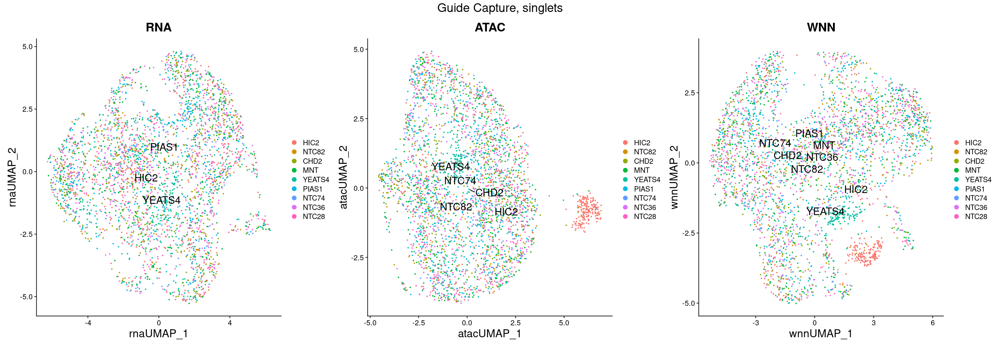

In [47]:
options(repr.plot.width = 23, repr.plot.height = 8)
#Idents(seurat_singlets) <- seurat_singlets@meta.data$guidecapture_classification

p1 <- DimPlot(seurat_singlets, reduction = "umap.rna", label = TRUE, label.size = 6, repel = TRUE) + ggtitle("RNA")
p2 <- DimPlot(seurat_singlets, reduction = "umap.atac", label = TRUE, label.size = 6, repel = TRUE) + ggtitle("ATAC")
p3 <- DimPlot(seurat_singlets, reduction = "wnn.umap", label = TRUE, label.size = 6, repel = TRUE) + ggtitle("WNN")
p1 + p2 + p3 & plot_annotation(title = "Guide Capture, singlets") & 
theme(plot.title = element_text(hjust = 0.5, size = 20)) +
theme(axis.title = element_text(size = 18))   

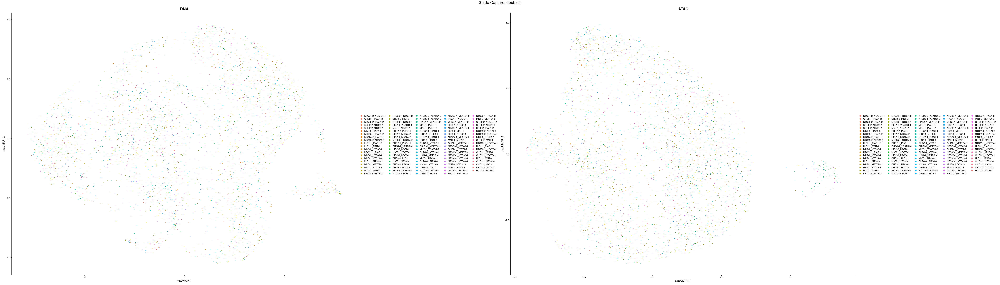

In [48]:
options(repr.plot.width = 70, repr.plot.height = 20)
p1 <- DimPlot(seurat_doublets, reduction = "umap.rna", label = FALSE, label.size = 6) + ggtitle("RNA")
p2 <- DimPlot(seurat_doublets, reduction = "umap.atac", label = FALSE, label.size = 6) + ggtitle("ATAC")
p1 + p2 & plot_annotation(title = "Guide Capture, doublets") &
theme(plot.title = element_text(hjust = 0.5, size = 20))

#p3 <- DimPlot(seurat_doublets, reduction = "wnn.umap", label = TRUE, label.size = 6, repel = TRUE) + ggtitle("WNN")

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: NTC28, NTC36, NTC74, NTC82”


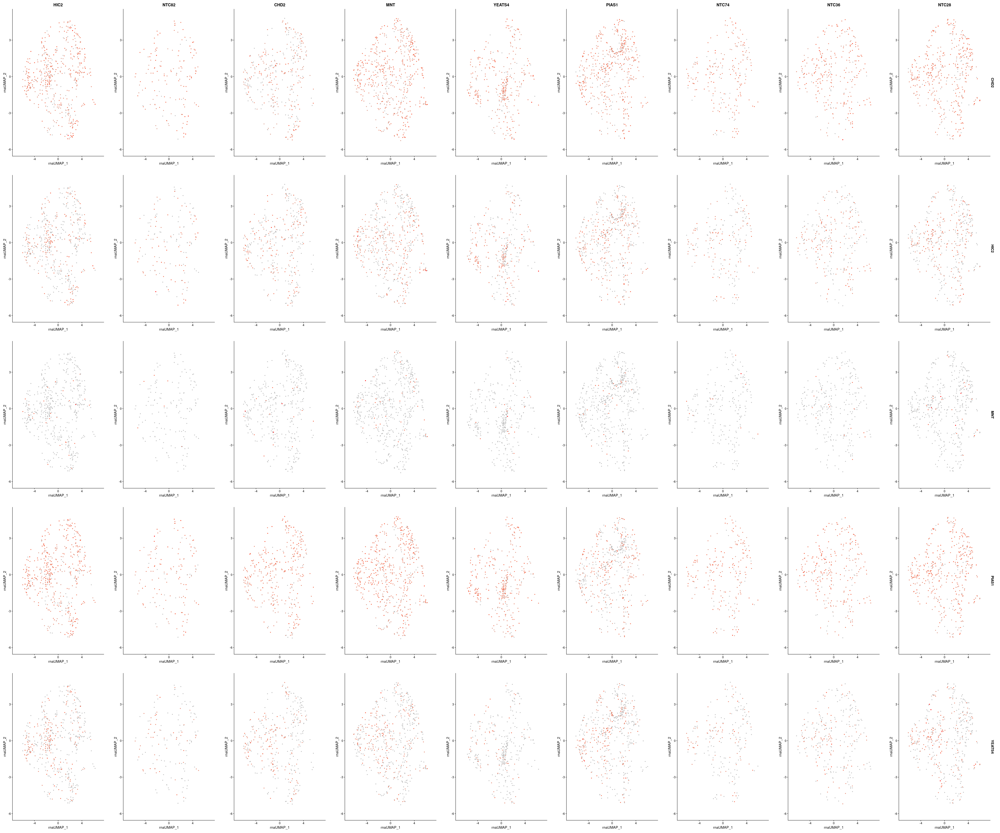

In [49]:
options(repr.plot.width = 54, repr.plot.height = 45)
tf_list <- tfs_to_plot

FeaturePlot(
    seurat_singlets,
    features = tf_list, 
    split.by = 'ident', 
    reduction = 'umap.rna', 
    cols = c("grey", "red"),
    keep.scale = "feature"
)

Warning message in matrix(seq_len(width * height), nrow = height, ncol = width, :
“data length [15] is not a sub-multiple or multiple of the number of rows [2]”


Warning message:
“Too few patch areas to hold all plots. Dropping plots”


Warning message:
“Could not find POU5F1 in the default search locations, found in RNA assay instead”


Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: NTC28, NTC36, NTC74, NTC82”


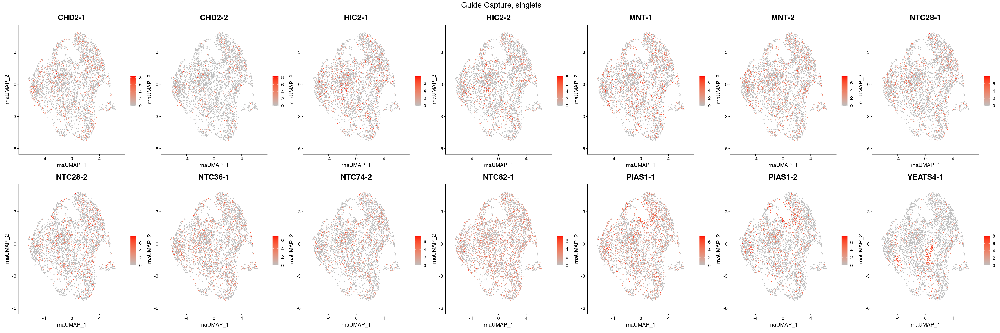

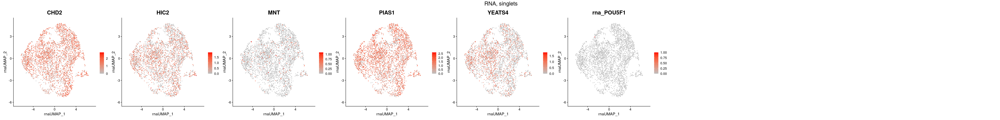

In [50]:
options(repr.plot.width = 36, repr.plot.height = 12)
guide_list <- gsub("_", "-", guides_to_plot)
DefaultAssay(seurat_singlets) <- "guidecapture"

FeaturePlot(
    seurat_singlets,
    features = guide_list,
    reduction = 'umap.rna',
    cols = c("grey", "red"),
    keep.scale = "feature",
    ncol = length(guide_list)/2
) +
plot_annotation(title = "Guide Capture, singlets") &
theme(plot.title = element_text(hjust = 0.5, size = 20))

options(repr.plot.width = 50, repr.plot.height = 6)
tf_list <- c(tfs_to_plot, "POU5F1")
DefaultAssay(seurat_singlets) <- "SCT"
FeaturePlot(
    seurat_singlets,
    features = tf_list,
    reduction = 'umap.rna',
    cols = c("grey", "red"),
    keep.scale = "feature",
    ncol = length(tf_list)
) +
plot_annotation(title = "RNA, singlets") &
theme(plot.title = element_text(hjust = 0.5, size = 20))



In [51]:
tfs_to_plot

[1] "CHD2"   "HIC2"   "MNT"    "NTC28"  "NTC36"  "NTC74"  "NTC82"  "PIAS1" 
[9] "YEATS4"

Warning message in matrix(seq_len(width * height), nrow = height, ncol = width, :
“data length [15] is not a sub-multiple or multiple of the number of rows [2]”


Warning message:
“Too few patch areas to hold all plots. Dropping plots”


Warning message in matrix(seq_len(width * height), nrow = height, ncol = width, :
“data length [15] is not a sub-multiple or multiple of the number of rows [2]”


Warning message:
“Too few patch areas to hold all plots. Dropping plots”


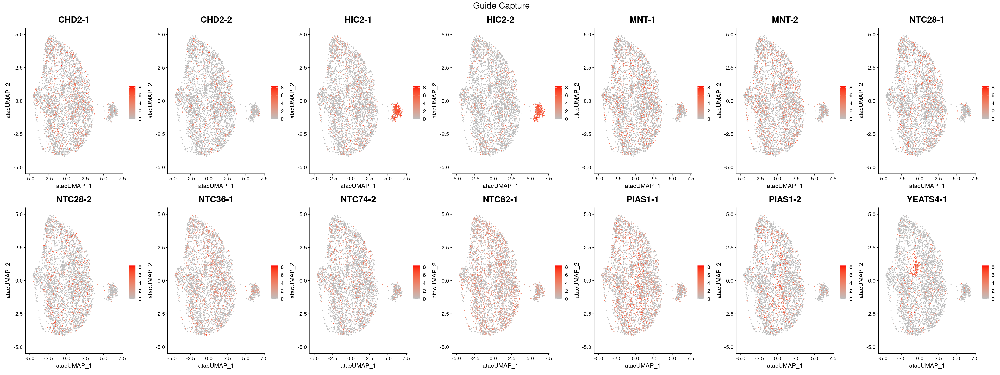

Warning message in matrix(seq_len(width * height), nrow = height, ncol = width, :
“data length [15] is not a sub-multiple or multiple of the number of rows [2]”


Warning message:
“Too few patch areas to hold all plots. Dropping plots”


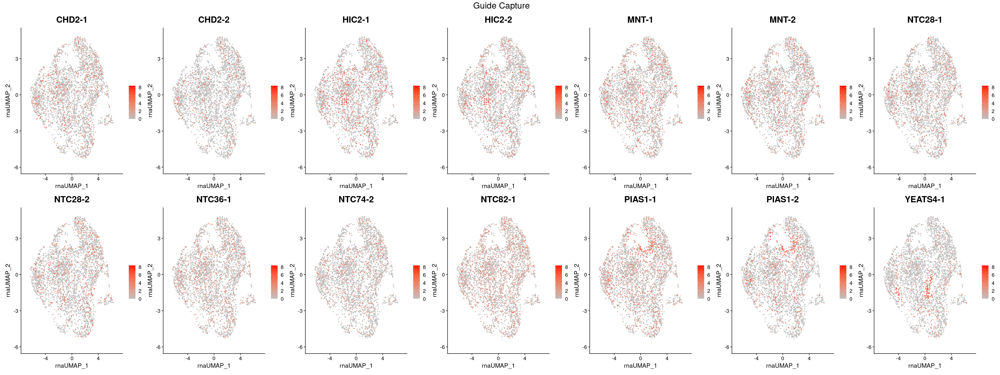

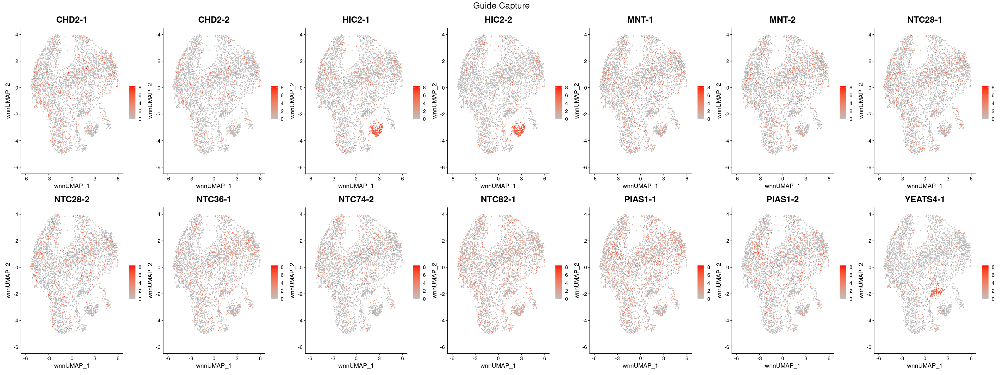

In [52]:
library(patchwork)
options(repr.plot.width = 32, repr.plot.height = 12)
tf_list <- tfs_to_plot
guide_list <- gsub("_", "-", guides_to_plot)

DefaultAssay(seurat_singlets) <- "guidecapture"
FeaturePlot(
    seurat_singlets,
    features = guide_list,
    reduction = 'umap.atac',
    cols = c("grey", "red"),
    keep.scale = "all",
    ncol = length(guide_list)/2
) +
plot_annotation(title = "Guide Capture") &
theme(plot.title = element_text(hjust = 0.5, size = 20))

FeaturePlot(
    seurat_singlets,
    features =guide_list,
    reduction = 'umap.rna',
    cols = c("grey", "red"),
    keep.scale = "all",
    ncol = length(guide_list)/2
) +
plot_annotation(title = "Guide Capture") &
theme(plot.title = element_text(hjust = 0.5, size = 20))

FeaturePlot(
    seurat_singlets,
    features = guide_list,
    reduction = 'wnn.umap',
    cols = c("grey", "red"),
    keep.scale = "all",
    ncol = length(guide_list)/2
) +
plot_annotation(title = "Guide Capture") &
theme(plot.title = element_text(hjust = 0.5, size = 20))



Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: NTC28, NTC36, NTC74, NTC82”


Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: NTC28, NTC36, NTC74, NTC82”


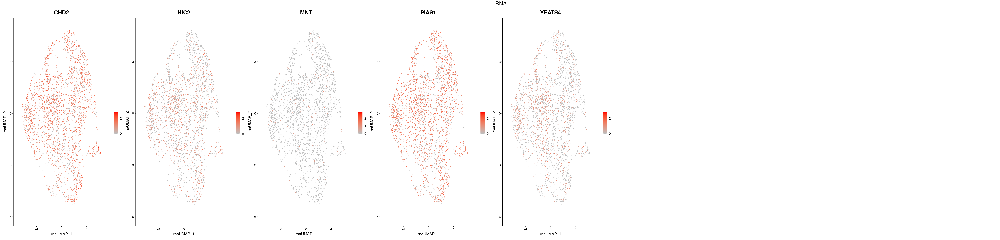

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: NTC28, NTC36, NTC74, NTC82”


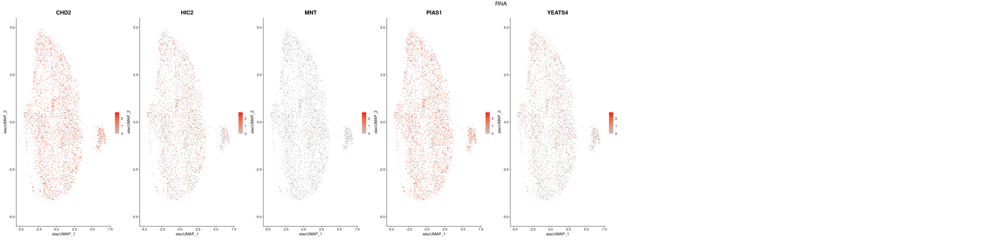

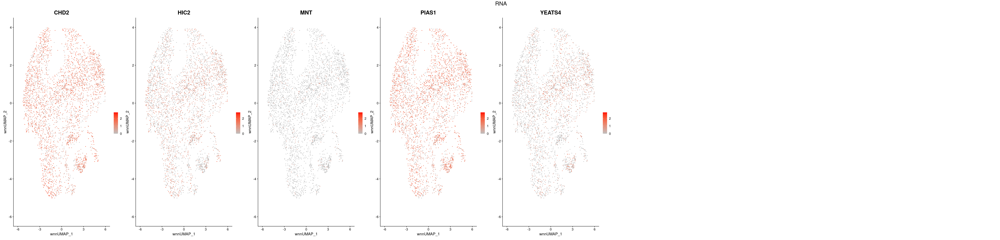

In [53]:

options(repr.plot.width = 50, repr.plot.height = 12)
tf_list <- tfs_to_plot
DefaultAssay(seurat_singlets) <- "SCT"

FeaturePlot(
    seurat_singlets,
    features = tf_list,
    reduction = 'umap.rna',
    cols = c("grey", "red"),
    keep.scale = "all",
    ncol = length(tf_list)
) +
plot_annotation(title = "RNA") &
theme(plot.title = element_text(hjust = 0.5, size = 20))

FeaturePlot(
    seurat_singlets,
    features = tf_list,
    reduction = 'umap.atac',
    cols = c("grey", "red"),
    keep.scale = "all",
    ncol = length(tf_list)
) +
plot_annotation(title = "RNA") &
theme(plot.title = element_text(hjust = 0.5, size = 20))

FeaturePlot(
    seurat_singlets,
    features = tf_list,
    reduction = 'wnn.umap',
    cols = c("grey", "red"),
    keep.scale = "all",
    ncol = length(tf_list)
) +
plot_annotation(title = "RNA") &
theme(plot.title = element_text(hjust = 0.5, size = 20))

## Doublets only

In [54]:
options(repr.plot.width = 8, repr.plot.height = 8)

Idents(seurat_doublets) <- seurat_doublets@meta.data$guidecapture_classification

plot <- DimPlot(
    seurat_doublets,
    reduction = "umap.rna"
)
LabelClusters(
    plot = plot,
    id = "ident"
)

ERROR while rich displaying an object: Error: The viewport may be too small to show this patchwork.
 Please make it larger.

Traceback:
1. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
2. tryCatchList(expr, classes, parentenv, handlers)
3. tryCatchOne(expr, names, parentenv, handlers[[1L]])
4. doTryCatch(return(expr), name, parentenv, handler)
5. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler)
6. repr::mime2repr[[mime]](obj)
7. repr_text.default(obj

In [55]:
# options(repr.plot.width = 48, repr.plot.height = 15)
# tf_list <- tfs_to_plot
# DefaultAssay(seurat_singlets) <- "SCT"

# FeaturePlot(
#     seurat_doublets,
#     features = tf_list, 
#     split.by = 'ident', 
#     reduction = 'umap.rna', 
#     cols = c("grey", "red"),
#     keep.scale = "all"
# )

# Get cell counts in clusters

In [56]:
Assays(seurat_singlets)

[1] "SCT"          "ATAC"         "RNA"          "guidecapture"

In [57]:

DefaultAssay(seurat_singlets) <- "RNA"
seurat_singlets@meta.data$seurat_clusters
seurat_singlets <- StashIdent(seurat_singlets, save.name = "current.ident")

[1] 9  6  1  3  1  0  7  1  7  0  1  6  2  2  6  9  3  12 6  4  2  6  10 0 
  [25] 8  3  5  3  0  6  4  4  8  3  10 1  1  9  0  0  7  7  3  4  6  0  3  2 
  [49] 0  5  11 4  5  4  1  1  4  5  3  8  10 5  0  5  1  9  12 0  0  0  1  2 
  [73] 6  0  7  3  1  7  1  9  0  0  1  4  1  0  4  9  1  2  0  1  7  2  5  9 
  [97] 0  1  1  9  4  1  2  2  9  7  5  7  1  1  0  3  2  3  0  1  6  3  1  5 
 [121] 0  9  0  9  2  11 3  2  2  5  2  2  8  6  8  1  0  0  7  3  2  0  0  8 
 [145] 6  1  1  5  1  5  3  6  0  0  1  0  4  8  5  8  8  2  2  2  8  3  3  2 
 [169] 6  4  4  0  4  0  1  4  5  9  0  10 8  1  3  5  0  3  11 0  5  1  0  2 
 [193] 1  1  1  3  3  0  10 1  2  3  5  5  0  2  9  0  10 2  2  0  10 4  2  0 
 [217] 2  9  5  10 8  2  1  3  0  10 4  7  4  1  1  0  7  6  6  1  9  1  0  1 
 [241] 11 4  7  1  7  0  1  3  5  5  3  2  6  8  3  9  7  10 3  0  1  2  2  8 
 [265] 9  0  8  3  12 1  2  1  3  10 2  8  1  5  3  0  1  9  0  1  4  3  0  6 
 [289] 0  0  0  10 2  11 4  1  12 1  2  7  1  4  0  2  2  3  2  0  0  2  0  3 
 [313] 11 6  3  5  3  4  3  7  4  1  1  12 0  6  2  6  5  8  0  6  0  1  2  0 
 [337] 0  3  2  2  9  10 2  0  1  1  1  9  4  0  9  1  0  0  3  8  9  8  3  3 
 [361] 1  1  0  5  0  0  2  9  0  10 8  2  2  3  0  5  1  0  2  6  0  5  9  1 
 [385] 3  10 6  0  1  4  6  0  8  1  4  1  12 8  4  10 2  5  0  5  3  5  0  2 
 [409] 0  12 2  6  0  7  1  3  0  3  1  3  2  5  7  0  5  6  3  0  5  6  3  11
 [433] 5  4  6  0  0  7  0  2  8  11 3  3  0  0  4  2  12 6  2  4  9  8  5  3 
 [457] 7  9  5  7  0  1  5  9  4  4  4  7  7  1  6  4  6  0  2  1  2  8  9  12
 [481] 0  1  3  0  1  2  0  9  0  5  0  2  0  6  1  3  2  0  3  1  3  3  0  1 
 [505] 4  0  8  6  5  6  7  2  12 2  10 6  3  3  1  2  11 0  0  3  4  1  0  4 
 [529] 3  1  8  7  9  5  0  5  1  1  9  0  2  1  0  0  6  9  3  2  1  12 1  2 
 [553] 1  9  4  5  7  2  3  0  3  0  2  1  2  11 1  5  0  1  5  1  1  10 3  3 
 [577] 4  1  0  3  3  9  8  10 8  9  2  0  1  0  10 0  6  0  7  9  2  0  1  0 
 [601] 5  3  8  3  9  1  4  5  4  4  9  2  2  1  2  2  10 9  4  11 12 1  1  4 
 [625] 5  5  9  3  7  1  11 0  2  2  4  9  0  3  0  6  1  10 0  0  11 6  2  11
 [649] 2  1  0  5  0  1  4  6  2  2  3  1  2  4  0  4  0  1  4  4  4  1  1  0 
 [673] 2  2  6  12 5  5  2  2  3  1  4  2  9  1  2  10 3  0  7  7  0  0  1  1 
 [697] 7  12 0  4  10 1  0  4  4  1  1  2  6  2  9  0  0  3  4  8  8  2  3  3 
 [721] 0  3  10 9  2  10 2  3  4  2  2  2  1  0  4  0  5  4  2  7  1  5  6  0 
 [745] 1  3  3  8  2  1  0  3  4  2  5  1  7  1  1  1  0  1  2  1  6  5  7  1 
 [769] 10 11 6  0  3  1  4  2  7  10 8  7  6  2  5  0  0  5  0  2  2  9  9  1 
 [793] 1  0  0  7  3  0  3  0  4  2  3  0  9  1  2  9  6  5  1  1  1  1  4  4 
 [817] 1  4  5  5  0  1  5  9  8  0  0  3  0  6  2  10 11 9  0  1  1  5  5  5 
 [841] 0  10 0  0  2  3  4  2  5  12 3  0  9  1  0  12 8  3  7  2  8  5  3  0 
 [865] 0  5  10 3  9  0  1  5  11 6  1  9  2  2  2  1  3  1  0  9  10 3  1  1 
 [889] 8  5  3  3  10 12 5  0  1  0  1  2  1  9  11 0  2  0  6  1  0  2  0  0 
 [913] 12 6  1  0  9  5  4  5  0  9  2  11 2  4  0  5  0  12 4  3  2  5  2  0 
 [937] 2  6  11 8  0  3  5  8  9  4  3  4  8  6  2  1  5  10 6  1  1  0  1  3 
 [961] 2  5  7  0  3  2  2  1  1  4  1  9  4  1  0  2  5  0  8  3  11 1  0  5 
 [985] 1  2  6  3  3  3  0  2  2  6  5  4  5  3  1  3  2  8  0  1  9  2  6  1 
[1009] 0  0  3  9  1  7  12 11 6  8  2  5  0  3  9  5  4  3  2  6  9  4  5  0 
[1033] 1  1  2  0  0  2  3  8  3  7  1  9  1  6  2  2  4  1  3  1  1  0  4  0 
[1057] 4  12 6  10 0  2  2  0  5  10 9  9  3  8  1  10 3  2  5  2  2  3  0  1 
[1081] 2  3  5  4  5  0  9  6  9  2  0  1  1  0  0  6  0  2  8  2  3  9  0  7 
[1105] 1  5  9  0  8  10 7  0  7  1  8  11 0  1  4  7  6  5  3  1  12 7  0  0 
[1129] 3  5  0  0  6  2  0  3  5  0  10 2  1  11 4  0  0  0  4  5  3  2  11 1 
[1153] 2  1  0  3  9  0  5  0  1  0  4  1  0  0  2  3  8  2  1  0  7  6  4  3 
[1177] 12 0  4  10 1  2  3  0  2  0  1  0  5  0  6  1  0  3  10 2  3  2  10 0 
[1201] 11 3  0  12 6  5  10 0  0  9  7  4  3  3  0  1

With Seurat 3.X, stashing identity classes can be accomplished with the following:
seurat_singlets[["current.ident"]] <- Idents(object = seurat_singlets)



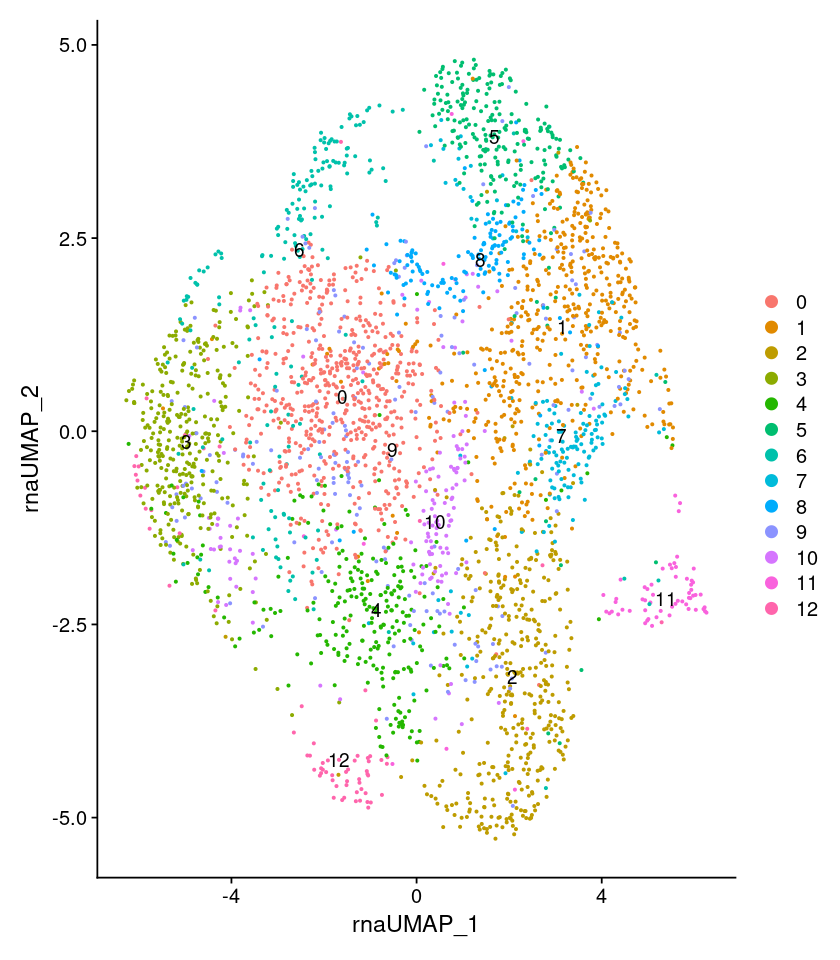

In [58]:
options(repr.plot.width = 7, repr.plot.height = 8)
seurat_singlets <- SetIdent(seurat_singlets, value = seurat_singlets@meta.data$seurat_clusters)
DimPlot(seurat_singlets, reduction = 'umap.rna', label = TRUE)

In [59]:
cluster_counts <- table(Idents(seurat_singlets))
as.data.frame(cluster_counts)


Var1,Freq
<fct>,<int>
0,600
1,529
2,404
3,340
4,260
5,236
6,193
7,156
8,143


In [60]:
#cluster_counts[['2']] + cluster_counts[['5']] + cluster_counts[['11']] + cluster_counts[['13']] + cluster_counts[['14']]

In [61]:
DefaultAssay(seurat_singlets) <- "guidecapture"
Idents(seurat_singlets) <- "guidecapture_classification"

In [62]:
# seurat_ngn2 <- subset(seurat_singlets, idents = tfs_w_ntctl[1])
# hist(seurat_ngn2@meta.data$SCT.weight)

In [63]:
#hist(seurat_ngn2$SCT@data[tfs_w_ntctl[1],])

Picking joint bandwidth of 0.0246



Picking joint bandwidth of 0.0243



Picking joint bandwidth of 0.0713



Picking joint bandwidth of 0.0248



Picking joint bandwidth of 0.0581



Picking joint bandwidth of 0.0233



Picking joint bandwidth of 0.0214



Picking joint bandwidth of 0.0272



Picking joint bandwidth of 0.17



Picking joint bandwidth of 0.0683



Picking joint bandwidth of 0.393



Picking joint bandwidth of 0.222



Picking joint bandwidth of 0.0229



Picking joint bandwidth of 0.0285



Picking joint bandwidth of 0.0324



Warning message in FetchData.Seurat(object = object, vars = features, slot = slot):
“The following requested variables were not found: NTC28, NTC36, NTC74, NTC82”


Picking joint bandwidth of 0.179



Picking joint bandwidth of 0.16



Picking joint bandwidth of 3.54e-06



Picking joint bandwidth of 0.173



Picking joint bandwidth of 0.133



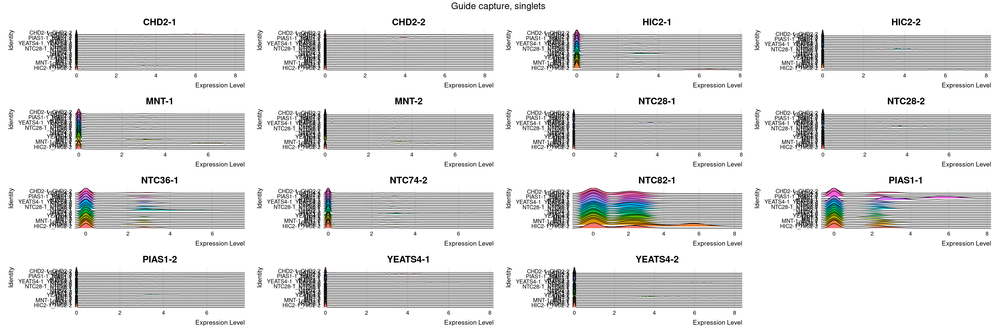

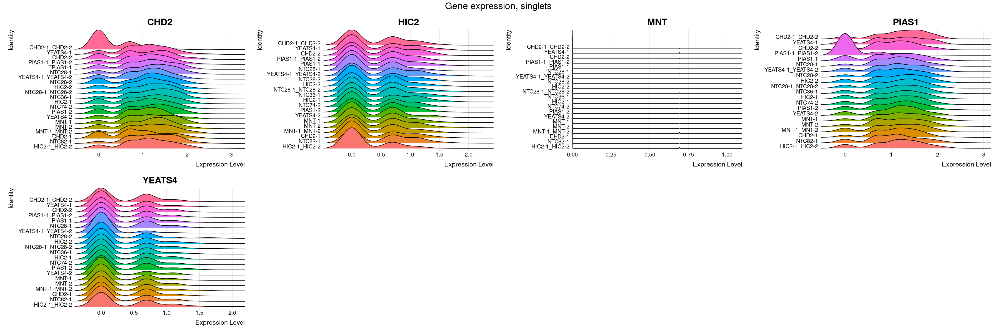

In [64]:
Idents(seurat_singlets) <- "guidecapture_classification"
options(repr.plot.width = 30, repr.plot.height = 10)
tf_list <- tfs_to_plot

Idents(seurat) <- "guidecapture_classification"
RidgePlot(
    seurat_singlets,
    assay = "guidecapture",
    features = guide_names,
    ncol = 4
) +
plot_annotation(title = "Guide capture, singlets") &
theme(plot.title = element_text(hjust = 0.5, size = 20))


RidgePlot(
    seurat_singlets,
    assay = "SCT",
    features = tf_list,
    ncol = 4,
) +
plot_annotation(title = "Gene expression, singlets") &
theme(plot.title = element_text(hjust = 0.5, size = 20))


# How many singlets express both Protospacer1 and 2?

In [65]:
singlet_barcodes <- Cells(seurat_singlets)

In [66]:
select_singlets <- df_guide$barcode_dash %in% singlet_barcodes
df_singlets     <- df_guide[select_singlets,]

In [67]:
singlets_metadata <- seurat_singlets@meta.data['guidecapture_classification']
singlets_metadata['barcode_dash'] <- rownames(singlets_metadata)
head(singlets_metadata)

,guidecapture_classification,barcode_dash
,<chr>,<chr>
AAACAGCCAGCATGGA-1,HIC2-1_HIC2-2,AAACAGCCAGCATGGA-1
AAACAGCCAGGCATCT-1,NTC82-1,AAACAGCCAGGCATCT-1
AAACAGCCATTAGCCA-1,CHD2-1,AAACAGCCATTAGCCA-1
AAACATGCAAAGCTCC-1,MNT-1_MNT-2,AAACATGCAAAGCTCC-1
AAACATGCAATAGCCC-1,MNT-2,AAACATGCAATAGCCC-1
AAACATGCACAGGGAC-1,MNT-1_MNT-2,AAACATGCACAGGGAC-1


In [68]:
df_singlets <- merge(df_singlets, singlets_metadata, by = "barcode_dash")

In [69]:
head(df_singlets)

,barcode_dash,barcode,n_guides,ADNP_1,ADNP_2,BRD2_1,BRD2_2,CHD2_1,CHD2_2,CNOT2_1,⋯,YEATS4_1,YEATS4_2,ZBED6_1,ZBED6_2,ZNF330_1,ZNF330_2,ZNF669_1,ZNF669_2,in_multiome,guidecapture_classification
,<chr>,<chr>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<lgl>,<chr>
1,AAACAGCCAGCATGGA-1,AAACAGCCAGCATGGA,1936,90,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,86,TRUE,HIC2-1_HIC2-2
2,AAACAGCCAGGCATCT-1,AAACAGCCAGGCATCT,5613,0,0,0,0,0,0,0,⋯,0,0,51,0,0,0,101,132,TRUE,NTC82-1
3,AAACAGCCATTAGCCA-1,AAACAGCCATTAGCCA,646,0,0,0,0,153,0,0,⋯,0,0,0,0,0,0,0,303,TRUE,CHD2-1
4,AAACATGCAAAGCTCC-1,AAACATGCAAAGCTCC,4242,250,0,0,0,144,240,0,⋯,0,0,0,0,0,0,0,1242,TRUE,MNT-1_MNT-2
5,AAACATGCAATAGCCC-1,AAACATGCAATAGCCC,3025,0,0,1790,0,0,0,0,⋯,0,0,0,0,0,0,0,0,TRUE,MNT-2
6,AAACATGCACAGGGAC-1,AAACATGCACAGGGAC,12313,0,0,0,0,68,0,0,⋯,0,0,0,0,0,0,0,0,TRUE,MNT-1_MNT-2


In [70]:
# # Count the singlets where both PSs are captured

# fracs_list <- list()
# guide_list <- c("NEUROG2", "MEOX1", "GATA5", "NTCTL")
# ps_list <- list(
#             'NEUROG2_pss' = c("NEUROG2_1", "NEUROG2_2"),
#             'MEOX1_pss' = c("MEOX1_1", "MEOX1_2"),
#             'GATA5_pss' = c("GATA5_1", "GATA5_2"),
#             'NTCTL_pss' = c("NTCTL_1", "NTCTL_2")
#         )

# for(guide in guide_list) {
#     ps_col_names <- c(paste0(guide, "_1"), paste0(guide, "_2"))
#     select_guide <- df_singlets$guidecapture_classification == guide
    
#     for(ps_pair in names(ps_list)){ 
#         ps_col_names <- ps_list[[ps_pair]]
#         df_dummy <- df_singlets[select_guide, ps_col_names]    
#         both_ps_captured <- (df_dummy[,1] > 0) & (df_dummy[,2] > 0)
#         frac_dual_ps <- round(sum(both_ps_captured)/nrow(df_dummy),2)
#         #print(paste(guide, ps_pair, frac_dual_ps))
#         fracs_list <- rbind(fracs_list, list(guide, ps_pair, frac_dual_ps))
#     }

    
# }

In [71]:
# For singlets
# V1 is assigned barcode
# V2 is the name of the gene/guide where both protospacers are detected in barcode
# V3 is the fraction of barcodes with the both protospacers of gene/guide in V2 

# as.data.frame(fracs_list)

In [72]:
# save singlets for downstream analysis
singlets_h5_w_gcap_name <- sub(".h5seurat", "_05_SINGLETS.h5seurat", h5_w_gcap_name)
SaveH5Seurat(seurat_singlets, singlets_h5_w_gcap_name, overwrite = TRUE, verbose = FALSE)

Warning message:
“Overwriting previous file /data2/kfeng/deeper_guides_dasatinib/secondary/DMSO2/seurat/CATATAC_CRISPR-DMSO2_ONLY_SINGLETS_w_GUIDE_CAP_05_SINGLETS.h5seurat”


Creating h5Seurat file for version 3.1.5.9900

